# Intention Prediction in Vehicular Environments
This is the full pipeline for the research project by Mitch Mathieu.<br>
Credit to Qiangui Huang and Xiaojian Ma for their contributions to the TensorFlow VoxelNet implementation.<br>
VoxelNet github: https://github.com/qianguih/voxelnet

# Data Processing

In [1]:
import os, os.path
import numpy as np
from config import cfg

### Choose Drive Sequence

In [2]:
# specify the date and drive number of the raw data sequence you would like to use
DATE = '2011_09_26'
DRIVE = '0017'

### Directories

In [3]:
# Change KITTI_DIR to where you store the KITTI 3D detection data
KITTI_DIR = 'data/KITTI/'

DATA_ROOT = 'data/validation/'
IMG_ROOT = 'data/validation/image_2/'
VELO_ROOT = 'data/validation/velodyne/'
CALIB_ROOT = 'data/data_object_calib/training/calib/'
LABEL_ROOT = 'data/validation/label_2/'
PRED_ROOT = 'predictions/vis'

In [4]:
def int_to_tag_format(num):
    if num<10:
        num_string = '00000{}'.format(num)
    elif num<100:
        num_string = '0000{}'.format(num)
    elif num<1000:
        num_string = '000{}'.format(num)
    else:
        num_string = '00{}'.format(num)
        
    return num_string

In [5]:
def move_files(index_list, path, dest_path, suffix):
    # index is a string number
    for i, index in enumerate(index_list):
        file_path = os.path.join(path, index + suffix)
        
        file_num = int_to_tag_format(i)
        
        file_dest = os.path.join(dest_path, file_num + suffix)
        cmd = 'cp {} {}'.format(file_path, file_dest)
        os.system(cmd)

## i) Read the Mapping Files

### train_rand
* each line in the file maps to the same frame in training dataset from KITTI 3D detection (i.e. `train_rand[0]` maps to frame `000000.png` in the training set)
* the value of each line in `train_rand.txt` is an index for the file `train_mapping.txt`

In [6]:
train_rand = open('utils/train_rand.txt', 'r').readlines()
train_rand = train_rand[0].split(',')

### train_rand_dict
* a dictionary that maps each index in `train_rand.txt` to the corresponding frame number in `training`
* this is implied through the structure of the file, but for our sake it's easier to make it explicit

In [7]:
# map each entry in train_rand to a file number in training
train_rand_dict = {}
for i, index in enumerate(train_rand):
    train_rand_dict[int(index)] = int_to_tag_format(i)

### train_mapping
* each entry in `train_mapping.txt` is a location in the KITTI raw data folders
* the entries in `train_rand` correspond with the implicit indexing in `train_mapping`
* this means you can use an entry from `train_rand` as an index for `train_mapping` to find the file location of a frame in the training set

In [8]:
train_mapping = open('utils/train_mapping.txt', 'r').readlines()

for i, line in enumerate(train_mapping):
    line = line.split(' ')
    line[2] = line[2].strip('\n')
    train_mapping[i] = line

## ii) Get Drive Sequence

In [9]:
# return the index of any matching date/drive combo
indexes = list()
for i, line in enumerate(train_mapping):
    if line[1] == '{}_drive_{}_sync'.format(DATE, DRIVE):
        print(line)
        indexes.append(i+1)

['2011_09_26', '2011_09_26_drive_0017_sync', '0000000001']
['2011_09_26', '2011_09_26_drive_0017_sync', '0000000002']
['2011_09_26', '2011_09_26_drive_0017_sync', '0000000003']
['2011_09_26', '2011_09_26_drive_0017_sync', '0000000004']
['2011_09_26', '2011_09_26_drive_0017_sync', '0000000005']
['2011_09_26', '2011_09_26_drive_0017_sync', '0000000006']
['2011_09_26', '2011_09_26_drive_0017_sync', '0000000011']
['2011_09_26', '2011_09_26_drive_0017_sync', '0000000012']
['2011_09_26', '2011_09_26_drive_0017_sync', '0000000013']
['2011_09_26', '2011_09_26_drive_0017_sync', '0000000014']
['2011_09_26', '2011_09_26_drive_0017_sync', '0000000015']
['2011_09_26', '2011_09_26_drive_0017_sync', '0000000016']
['2011_09_26', '2011_09_26_drive_0017_sync', '0000000017']
['2011_09_26', '2011_09_26_drive_0017_sync', '0000000018']
['2011_09_26', '2011_09_26_drive_0017_sync', '0000000019']
['2011_09_26', '2011_09_26_drive_0017_sync', '0000000020']
['2011_09_26', '2011_09_26_drive_0017_sync', '0000000023

In [10]:
# use indexes and the train_rand_dict to get the file names
file_names = list()
for x in indexes:
    file_names.append(train_rand_dict[x])
print(file_names)

['003144', '007271', '004807', '003504', '001927', '001386', '004437', '001239', '003090', '004815', '005304', '003411', '002120', '000504', '003926', '004189', '006086', '004589', '003835', '004079', '003449', '002089', '006227', '003607', '004849', '004489', '001067', '001905', '002528', '000414', '005445', '005961', '007322', '000779', '005292', '001066', '002429', '003174']


### moving the files
Create a new directory and move the appropriate files <br>
Files to move:
* filenum.png (rgb image)
* filenum.bin (velodyne)
* filename.txt (label)
* filename.txt (calibration)

In [11]:
# remove the directory if it already exists
os.system('rm -r {}'.format(DATA_ROOT))
os.system('rm -r {}'.format(CALIB_ROOT))

# make the new directory structure
os.system('mkdir -p {}/{{label_2,image_2,velodyne}}'.format(DATA_ROOT))
os.system('mkdir -p {}'.format(CALIB_ROOT))

0

In [12]:
# set directories for data sources
image_base = os.path.join(KITTI_DIR, 'data_object_image_2/training/image_2/')
velo_base = os.path.join(KITTI_DIR, 'data_object_velodyne/training/velodyne/')
label_base = os.path.join(KITTI_DIR, 'data_object_label_2/training/label_2/')
calib_base = os.path.join(KITTI_DIR, 'data_object_calib/training/calib/')

In [13]:
move_files(file_names, image_base, IMG_ROOT, '.png')

In [14]:
move_files(file_names, velo_base, VELO_ROOT, '.bin')

In [15]:
move_files(file_names, label_base, LABEL_ROOT, '.txt')

In [16]:
move_files(file_names, calib_base, CALIB_ROOT, '.txt')

## iii) Crop LiDAR Point Clouds
Crop the LiDAR point clouds so that only points that project onto the camera image are considered. The script for cropping the point clouds is from the VoxelNet implementation by Qiangui Huang

In [17]:
import data.crop as crop

NUM_FILES = len([name for name in os.listdir(IMG_ROOT) if os.path.isfile(os.path.join(IMG_ROOT, name))])

for frame in range(NUM_FILES):
    img_dir = IMG_ROOT + '%06d.png' % frame
    pc_dir = VELO_ROOT + '%06d.bin' % frame
    calib_dir = CALIB_ROOT + '%06d.txt' % frame

    points = crop.align_img_and_pc(img_dir, pc_dir, calib_dir)
    
    output_name = '{}{}.bin'.format(VELO_ROOT, int_to_tag_format(frame))
    
    points[:,:4].astype('float32').tofile(output_name)

# VoxelNet — 3D Bounding Box Predictions from LiDAR
The following code, under `Model` and `Predictions` is modified from the VoxelNet implementation by Qiangui Huang

## Model
Only code related to making predictions was kept

In [18]:
import sys
import os
import tensorflow as tf
import cv2
from numba import jit

from utils import *
from model.group_pointcloud import FeatureNet
from model.rpn import MiddleAndRPN


class RPN3DJ(object):

    def __init__(self,
                 cls='Car',
                 single_batch_size=2,  # batch_size_per_gpu
                 learning_rate=0.001,
                 max_gradient_norm=5.0,
                 alpha=1.5,
                 beta=1,
                 avail_gpus=['0']):
        # hyper parameters and status
        self.cls = cls
        self.single_batch_size = single_batch_size
        self.learning_rate = tf.Variable(
            float(learning_rate), trainable=False, dtype=tf.float32)
        self.global_step = tf.Variable(1, trainable=False)
        self.epoch = tf.Variable(0, trainable=False)
        self.epoch_add_op = self.epoch.assign(self.epoch + 1)
        self.alpha = alpha
        self.beta = beta
        self.avail_gpus = avail_gpus

        boundaries = [80, 120]
        values = [ self.learning_rate, self.learning_rate * 0.1, self.learning_rate * 0.01 ]
        lr = tf.train.piecewise_constant(self.epoch, boundaries, values)

        # build graph
        # input placeholders
        self.is_train = tf.placeholder(tf.bool, name='phase')

        self.vox_feature = []
        self.vox_number = []
        self.vox_coordinate = []
        self.targets = []
        self.pos_equal_one = []
        self.pos_equal_one_sum = []
        self.pos_equal_one_for_reg = []
        self.neg_equal_one = []
        self.neg_equal_one_sum = []

        self.delta_output = []
        self.prob_output = []
        self.opt = tf.train.AdamOptimizer(lr)
        self.gradient_norm = []
        self.tower_grads = []
        with tf.variable_scope(tf.get_variable_scope()):
            for idx, dev in enumerate(self.avail_gpus):
                with tf.device('/gpu:{}'.format(dev)), tf.name_scope('gpu_{}'.format(dev)):
                    # must use name scope here since we do not want to create new variables
                    # graph
                    feature = FeatureNet(
                        training=self.is_train, batch_size=self.single_batch_size)
                    rpn = MiddleAndRPN(
                        input=feature.outputs, alpha=self.alpha, beta=self.beta, training=self.is_train)
                    tf.get_variable_scope().reuse_variables()
                    # input
                    self.vox_feature.append(feature.feature)
                    self.vox_number.append(feature.number)
                    self.vox_coordinate.append(feature.coordinate)
                    self.targets.append(rpn.targets)
                    self.pos_equal_one.append(rpn.pos_equal_one)
                    self.pos_equal_one_sum.append(rpn.pos_equal_one_sum)
                    self.pos_equal_one_for_reg.append(
                        rpn.pos_equal_one_for_reg)
                    self.neg_equal_one.append(rpn.neg_equal_one)
                    self.neg_equal_one_sum.append(rpn.neg_equal_one_sum)
                    # output
                    feature_output = feature.outputs
                    delta_output = rpn.delta_output
                    prob_output = rpn.prob_output
                    # loss and grad
                    if idx == 0:
                        self.extra_update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)

                    self.loss = rpn.loss
                    self.reg_loss = rpn.reg_loss
                    self.cls_loss = rpn.cls_loss
                    self.cls_pos_loss = rpn.cls_pos_loss_rec
                    self.cls_neg_loss = rpn.cls_neg_loss_rec
                    self.params = tf.trainable_variables()
                    gradients = tf.gradients(self.loss, self.params)
                    clipped_gradients, gradient_norm = tf.clip_by_global_norm(
                        gradients, max_gradient_norm)

                    self.delta_output.append(delta_output)
                    self.prob_output.append(prob_output)
                    self.tower_grads.append(clipped_gradients)
                    self.gradient_norm.append(gradient_norm)
                    self.rpn_output_shape = rpn.output_shape

        self.vars = tf.get_collection(tf.GraphKeys.GLOBAL_VARIABLES)

        # loss and optimizer
        # self.xxxloss is only the loss for the lowest tower
        with tf.device('/gpu:{}'.format(self.avail_gpus[0])):
            self.grads = average_gradients(self.tower_grads)
            self.update = [self.opt.apply_gradients(
                zip(self.grads, self.params), global_step=self.global_step)]
            self.gradient_norm = tf.group(*self.gradient_norm)

        self.update.extend(self.extra_update_ops)
        self.update = tf.group(*self.update)

        self.delta_output = tf.concat(self.delta_output, axis=0)
        self.prob_output = tf.concat(self.prob_output, axis=0)

        self.anchors = cal_anchors()
        # for predict and image summary
        self.rgb = tf.placeholder(
            tf.uint8, [None, cfg.IMAGE_HEIGHT, cfg.IMAGE_WIDTH, 3])
        self.bv = tf.placeholder(tf.uint8, [
                                 None, cfg.BV_LOG_FACTOR * cfg.INPUT_HEIGHT, cfg.BV_LOG_FACTOR * cfg.INPUT_WIDTH, 3])
        self.bv_heatmap = tf.placeholder(tf.uint8, [
            None, cfg.BV_LOG_FACTOR * cfg.FEATURE_HEIGHT, cfg.BV_LOG_FACTOR * cfg.FEATURE_WIDTH, 3])
        self.boxes2d = tf.placeholder(tf.float32, [None, 4])
        self.boxes2d_scores = tf.placeholder(tf.float32, [None])

        # NMS(2D)
        with tf.device('/gpu:{}'.format(self.avail_gpus[0])):
            self.box2d_ind_after_nms = tf.image.non_max_suppression(
                self.boxes2d, self.boxes2d_scores, max_output_size=cfg.RPN_NMS_POST_TOPK, iou_threshold=cfg.RPN_NMS_THRESH)

        # summary and saver
        self.saver = tf.train.Saver(write_version=tf.train.SaverDef.V2,
                                    max_to_keep=10, pad_step_number=True, keep_checkpoint_every_n_hours=1.0)

        self.train_summary = tf.summary.merge([
            tf.summary.scalar('train/loss', self.loss),
            tf.summary.scalar('train/reg_loss', self.reg_loss),
            tf.summary.scalar('train/cls_loss', self.cls_loss),
            tf.summary.scalar('train/cls_pos_loss', self.cls_pos_loss),
            tf.summary.scalar('train/cls_neg_loss', self.cls_neg_loss),
            *[tf.summary.histogram(each.name, each) for each in self.vars + self.params]
        ])

        self.validate_summary = tf.summary.merge([
            tf.summary.scalar('validate/loss', self.loss),
            tf.summary.scalar('validate/reg_loss', self.reg_loss),
            tf.summary.scalar('validate/cls_loss', self.cls_loss),
            tf.summary.scalar('validate/cls_pos_loss', self.cls_pos_loss),
            tf.summary.scalar('validate/cls_neg_loss', self.cls_neg_loss)
        ])

        # TODO: bird_view_summary and front_view_summary

        self.predict_summary = tf.summary.merge([
            tf.summary.image('predict/bird_view_lidar', self.bv),
            tf.summary.image('predict/bird_view_heatmap', self.bv_heatmap),
            tf.summary.image('predict/front_view_rgb', self.rgb),
        ])

    def predict_step(self, session, data, summary=False, vis=False):
        # input:
        #     (N) tag
        #     (N, N') label(can be empty)
        #     vox_feature
        #     vox_number
        #     vox_coordinate
        #     img (N, w, l, 3)
        #     lidar (N, N', 4)
        # output: A, B, C
        #     A: (N) tag
        #     B: (N, N') (class, x, y, z, h, w, l, rz, score)
        #     C; summary(optional)
        tag = data[0]
        label = data[1]
        vox_feature = data[2]
        vox_number = data[3]
        vox_coordinate = data[4]
        img = data[5]
        lidar = data[6]

        if summary or vis:
            batch_gt_boxes3d = label_to_gt_box3d(
                label, cls=self.cls, coordinate='lidar')
        print('predict', tag)
        input_feed = {}
        input_feed[self.is_train] = False
        for idx in range(len(self.avail_gpus)):
            input_feed[self.vox_feature[idx]] = vox_feature[idx]
            input_feed[self.vox_number[idx]] = vox_number[idx]
            input_feed[self.vox_coordinate[idx]] = vox_coordinate[idx]

        output_feed = [self.prob_output, self.delta_output]
        probs, deltas = session.run(output_feed, input_feed)
        # BOTTLENECK
        batch_boxes3d = delta_to_boxes3d(
            deltas, self.anchors, coordinate='lidar')
        batch_boxes2d = batch_boxes3d[:, :, [0, 1, 4, 5, 6]]
        batch_probs = probs.reshape(
            (len(self.avail_gpus) * self.single_batch_size, -1))
        # NMS
        ret_box3d = []
        ret_score = []
        for batch_id in range(len(self.avail_gpus) * self.single_batch_size):
            # remove box with low score
            ind = np.where(batch_probs[batch_id, :] >= cfg.RPN_SCORE_THRESH)[0]
            tmp_boxes3d = batch_boxes3d[batch_id, ind, ...]
            tmp_boxes2d = batch_boxes2d[batch_id, ind, ...]
            tmp_scores = batch_probs[batch_id, ind]

            # TODO: if possible, use rotate NMS
            boxes2d = corner_to_standup_box2d(
                center_to_corner_box2d(tmp_boxes2d, coordinate='lidar'))
            ind = session.run(self.box2d_ind_after_nms, {
                self.boxes2d: boxes2d,
                self.boxes2d_scores: tmp_scores
            })
            tmp_boxes3d = tmp_boxes3d[ind, ...]
            tmp_scores = tmp_scores[ind]
            ret_box3d.append(tmp_boxes3d)
            ret_score.append(tmp_scores)

        ret_box3d_score = []
        for boxes3d, scores in zip(ret_box3d, ret_score):
            ret_box3d_score.append(np.concatenate([np.tile(self.cls, len(boxes3d))[:, np.newaxis],
                                                   boxes3d, scores[:, np.newaxis]], axis=-1))

        if summary:
            # only summry 1 in a batch
            cur_tag = tag[0]
            P, Tr, R = load_calib( os.path.join( cfg.CALIB_DIR, cur_tag + '.txt' ) )
            
            front_image = draw_lidar_box3d_on_image(img[0], ret_box3d[0], ret_score[0],
                                                    batch_gt_boxes3d[0], P2=P, T_VELO_2_CAM=Tr, R_RECT_0=R)
            
            bird_view = lidar_to_bird_view_img(
                lidar[0], factor=cfg.BV_LOG_FACTOR)
                
            bird_view = draw_lidar_box3d_on_birdview(bird_view, ret_box3d[0], ret_score[0],
                                                     batch_gt_boxes3d[0], factor=cfg.BV_LOG_FACTOR, P2=P, T_VELO_2_CAM=Tr, R_RECT_0=R)
            
            heatmap = colorize(probs[0, ...], cfg.BV_LOG_FACTOR)
        
            ret_summary = session.run(self.predict_summary, {
                self.rgb: front_image[np.newaxis, ...],
                self.bv: bird_view[np.newaxis, ...],
                self.bv_heatmap: heatmap[np.newaxis, ...]
            })

            return tag, ret_box3d_score, ret_summary
        
        if vis:
            front_images, bird_views, heatmaps = [], [], []
            for i in range(len(img)):
                cur_tag = tag[i]
                P, Tr, R = load_calib( os.path.join( cfg.CALIB_DIR, cur_tag + '.txt' ) )
                
                front_image = draw_lidar_box3d_on_image(img[i], ret_box3d[i], ret_score[i],
                                                 batch_gt_boxes3d[i], P2=P, T_VELO_2_CAM=Tr, R_RECT_0=R)
                                                 
                bird_view = lidar_to_bird_view_img(
                                                 lidar[i], factor=cfg.BV_LOG_FACTOR)
                                                 
                bird_view = draw_lidar_box3d_on_birdview(bird_view, ret_box3d[i], ret_score[i],
                                                 batch_gt_boxes3d[i], factor=cfg.BV_LOG_FACTOR, P2=P, T_VELO_2_CAM=Tr, R_RECT_0=R)
                
                heatmap = colorize(probs[i, ...], cfg.BV_LOG_FACTOR)
                
                front_images.append(front_image)
                bird_views.append(bird_view)
                heatmaps.append(heatmap)
            
            return tag, ret_box3d, ret_score, ret_box3d_score, front_images, bird_views, heatmaps

        return tag, ret_box3d_score


def average_gradients(tower_grads):
    # ref:
    # https://github.com/tensorflow/models/blob/6db9f0282e2ab12795628de6200670892a8ad6ba/tutorials/image/cifar10/cifar10_multi_gpu_train.py#L103
    # but only contains grads, no vars
    average_grads = []
    for grad_and_vars in zip(*tower_grads):
        grads = []
        for g in grad_and_vars:
            # Add 0 dimension to the gradients to represent the tower.
            expanded_g = tf.expand_dims(g, 0)

            # Append on a 'tower' dimension which we will average over below.
            grads.append(expanded_g)

        # Average over the 'tower' dimension.
        grad = tf.concat(axis=0, values=grads)
        grad = tf.reduce_mean(grad, 0)

        # Keep in mind that the Variables are redundant because they are shared
        # across towers. So .. we will just return the first tower's pointer to
        # the Variable.
        grad_and_var = grad
        average_grads.append(grad_and_var)
    return average_grads


## Predictions

In [19]:
import glob
import argparse
import os
import time
import tensorflow as tf
import matplotlib.pyplot as plt

from utils import *
from utils.kitti_loader import iterate_data, sample_test_data

In [20]:
def predict(tag='pre_trained_car', output_path='./predictions', single_batch_size=2, vis=True):
    boxes3d = {}
    dataset_dir = cfg.DATA_DIR
    val_dir = os.path.join(cfg.DATA_DIR, 'validation')
    save_model_dir = os.path.join('./save_model', tag)

    # create output folder
    os.makedirs(output_path, exist_ok=True)
    os.makedirs(os.path.join(output_path, 'data'), exist_ok=True)
    if vis:
        os.makedirs(os.path.join(output_path, 'vis'), exist_ok=True)

    
    ret_box3d = []
    with tf.Graph().as_default():

        gpu_options = tf.GPUOptions(per_process_gpu_memory_fraction=cfg.GPU_MEMORY_FRACTION,
                            visible_device_list=cfg.GPU_AVAILABLE,
                            allow_growth=True)

        config = tf.ConfigProto(
            gpu_options=gpu_options,
            device_count={
                "GPU": cfg.GPU_USE_COUNT,
            },
            allow_soft_placement=True,
        )

        with tf.Session(config=config) as sess:
            model = RPN3DJ(
                cls=cfg.DETECT_OBJ,
                single_batch_size=single_batch_size,
                avail_gpus=cfg.GPU_AVAILABLE.split(',')
            )
            if tf.train.get_checkpoint_state(save_model_dir):
                print("Reading model parameters from %s" % save_model_dir)
                model.saver.restore(
                    sess, tf.train.latest_checkpoint(save_model_dir))


            for batch in iterate_data(val_dir, shuffle=False, aug=False, is_testset=False, batch_size=single_batch_size * cfg.GPU_USE_COUNT, multi_gpu_sum=cfg.GPU_USE_COUNT):

                if vis:
                    tags, ret_box3d, ret_score, results, front_images, bird_views, heatmaps = model.predict_step(sess, batch, summary=False, vis=True)

                    for tag, boxes in zip(tags, ret_box3d):
                        boxes3d[tag] = boxes
                else:
                    tags, results = model.predict_step(sess, batch, summary=False, vis=False)

                # ret: A, B
                # A: (N) tag
                # B: (N, N') (class, x, y, z, h, w, l, rz, score)
                for tag, result in zip(tags, results):
                    of_path = os.path.join(output_path, 'data', tag + '.txt')
                    with open(of_path, 'w+') as f:
                        labels = box3d_to_label([result[:, 1:8]], [result[:, 0]], [result[:, -1]], coordinate='lidar')[0]
                        for line in labels:
                            f.write(line)
                        print('write out {} objects to {}'.format(len(labels), tag))
                # dump visualizations
                if vis:
                    for tag, front_image, bird_view, heatmap in zip(tags, front_images, bird_views, heatmaps):
                        front_img_path = os.path.join( output_path, 'vis', tag + '_front.jpg'  )
                        bird_view_path = os.path.join( output_path, 'vis', tag + '_bv.jpg'  )
                        heatmap_path = os.path.join( output_path, 'vis', tag + '_heatmap.jpg'  )
                        cv2.imwrite( front_img_path, front_image )
                        cv2.imwrite( bird_view_path, bird_view )
                        cv2.imwrite( heatmap_path, heatmap )
                        
    return boxes3d

In [21]:
boxes3d = predict()




Instructions for updating:
keep_dims is deprecated, use keepdims instead
Instructions for updating:
Please use `layer.__call__` method instead.
Instructions for updating:
Use `tf.keras.layers.Conv3D` instead.
Instructions for updating:
Use keras.layers.BatchNormalization instead.  In particular, `tf.control_dependencies(tf.GraphKeys.UPDATE_OPS)` should not be used (consult the `tf.keras.layers.batch_normalization` documentation).
Instructions for updating:
Use `tf.keras.layers.Conv2D` instead.
Instructions for updating:
Use `tf.keras.layers.Conv2DTranspose` instead.

Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
INFO:tensorflow:Summary name Variable:0 is illegal; using Variable_0 instead.
INFO:tensorflow:Summary name Variable_1:0 is illegal; using Variable_1_0 instead.
INFO:tensorflow:Summary name Variable_2:0 is illegal; using Variable_2_0 instead.
INFO:tensorflow:Summary name VFE-1/kernel:0 is illegal; using VFE-1/kernel_0 instead.
I

INFO:tensorflow:Summary name MiddleAndRPN_/conv6/beta:0 is illegal; using MiddleAndRPN_/conv6/beta_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv6/moving_mean:0 is illegal; using MiddleAndRPN_/conv6/moving_mean_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv6/moving_variance:0 is illegal; using MiddleAndRPN_/conv6/moving_variance_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv7/kernel:0 is illegal; using MiddleAndRPN_/conv7/kernel_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv7/bias:0 is illegal; using MiddleAndRPN_/conv7/bias_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv7/gamma:0 is illegal; using MiddleAndRPN_/conv7/gamma_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv7/beta:0 is illegal; using MiddleAndRPN_/conv7/beta_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv7/moving_mean:0 is illegal; using MiddleAndRPN_/conv7/moving_mean_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv7/moving_variance

INFO:tensorflow:Summary name MiddleAndRPN_/conv16/kernel:0 is illegal; using MiddleAndRPN_/conv16/kernel_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv16/bias:0 is illegal; using MiddleAndRPN_/conv16/bias_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv16/gamma:0 is illegal; using MiddleAndRPN_/conv16/gamma_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv16/beta:0 is illegal; using MiddleAndRPN_/conv16/beta_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv16/moving_mean:0 is illegal; using MiddleAndRPN_/conv16/moving_mean_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv16/moving_variance:0 is illegal; using MiddleAndRPN_/conv16/moving_variance_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv17/kernel:0 is illegal; using MiddleAndRPN_/conv17/kernel_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv17/bias:0 is illegal; using MiddleAndRPN_/conv17/bias_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv17/gamma:0 

INFO:tensorflow:Summary name MiddleAndRPN_/conv8/kernel:0 is illegal; using MiddleAndRPN_/conv8/kernel_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv8/bias:0 is illegal; using MiddleAndRPN_/conv8/bias_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv8/gamma:0 is illegal; using MiddleAndRPN_/conv8/gamma_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv8/beta:0 is illegal; using MiddleAndRPN_/conv8/beta_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv9/kernel:0 is illegal; using MiddleAndRPN_/conv9/kernel_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv9/bias:0 is illegal; using MiddleAndRPN_/conv9/bias_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv9/gamma:0 is illegal; using MiddleAndRPN_/conv9/gamma_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv9/beta:0 is illegal; using MiddleAndRPN_/conv9/beta_0 instead.
INFO:tensorflow:Summary name MiddleAndRPN_/conv10/kernel:0 is illegal; using MiddleAndRPN_/conv10/kernel_0 i

predict ['000032' '000033' '000034' '000035']
write out 1 objects to 000032
write out 1 objects to 000033
write out 1 objects to 000034
write out 1 objects to 000035


### Bounding Box Visualizations

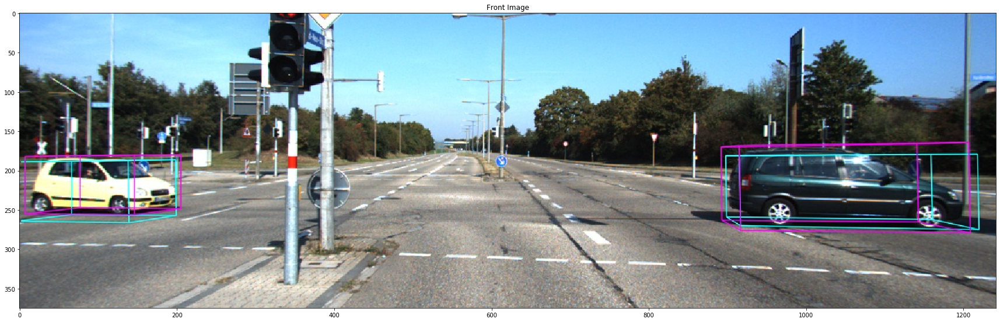

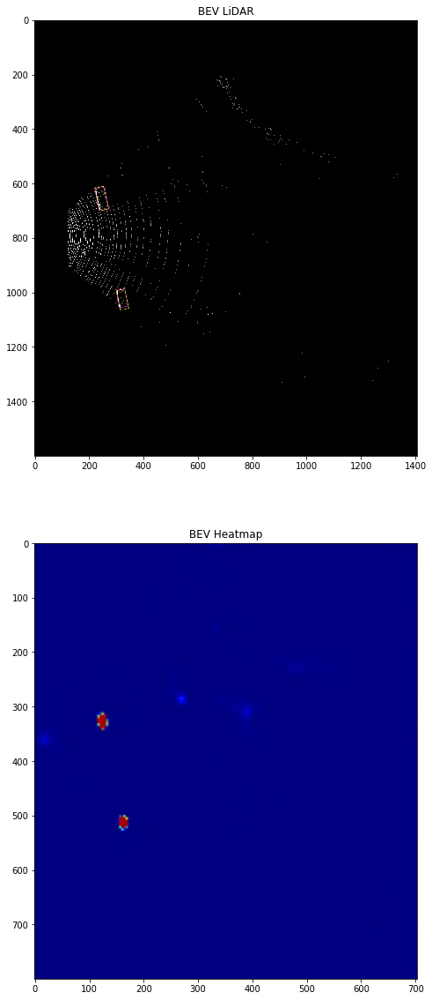

In [22]:
front = cv2.resize(cv2.imread(os.path.join(PRED_ROOT, '000002_front.jpg')), (cfg.IMAGE_WIDTH, cfg.IMAGE_HEIGHT))
bev = cv2.imread(os.path.join(PRED_ROOT, '000002_bv.jpg'))
heatmap = cv2.imread(os.path.join(PRED_ROOT, '000002_heatmap.jpg'))

f, ax = plt.subplots(figsize=(30,15))
ax.imshow(front)
ax.set_title('Front Image')
plt.show()

f, ax = plt.subplots(2, 1, figsize=(12,20))
ax[0].imshow(bev)
ax[0].set_title('BEV LiDAR')
ax[1].imshow(heatmap)
ax[1].set_title('BEV Heatmap')
plt.show()

# Object Tracking

In [23]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.exceptions import NotFittedError

NUM_FRAMES = len(boxes3d)

### Car Class
A new instance of this Car class will be created for each unique car observed by the object tracking algorithm.

In [24]:
"""
Attributes:
    name             — unique identifier for each instance
    bounding_boxes   — a dictionary mapping bounding boxes to their corresponding frames
    reg_model        — unique regression model
    reg_model_fitted — boolean flag for checking if the regression model has been trained
    
Functions:
    train_reg_model — trains the regression model on the first 70% of the bounding boxes
                      and set reg_model_fitted flag to be True
    predict         — make predictions based on the frames provided and
                      return predictions
    test            — test the accuracy of the regression model on the last 30% of the bounding boxes and
                      return MAE, MSE and predictions
"""
class Car:
    def __init__(self, num):
        self.name = 'Car{}'.format(num)
        self.bounding_boxes = {}
        self.reg_model = LinearRegression()
        self.reg_model_fitted = False
    
    def train_reg_model(self):
        start_index = list(self.bounding_boxes)[0]
        train_index =  start_index + int(len(self.bounding_boxes) * 0.7)
        X_train = []
        y_train = []
        for frame in range(start_index, train_index):
            if (isinstance(self.bounding_boxes[frame], np.ndarray)):
                X_train.append(frame)
                y_train.append(self.bounding_boxes[frame])

        X_train = np.array(X_train).reshape(-1,1)
        y_train = np.array(y_train)
        if (len(y_train) < 2):
            print('Not enough examples to train {}'.format(self.name))
        else:
            self.reg_model.fit(X_train, y_train)
            self.reg_model_fitted = True
    
    def predict(self, frames):
        if (isinstance(frames, int)):
            frames = [[frames]]
        elif(np.array(frames).ndim == 1):
            frames = np.array(frames).reshape(-1,1)
        X_test = frames
        
        if self.reg_model_fitted:
            preds = self.reg_model.predict(X_test)
            return preds
        else:
            print('The regression model for {} has not been fitted'.format(self.name))
            return np.array([[]])
    
    def test(self):
        end_index = list(self.bounding_boxes)[-1]
        test_index = end_index - int(len(self.bounding_boxes) * 0.3)
        frame_range = (test_index, end_index)
        X_test = []
        y_test = []
        for frame in range(test_index, end_index+1):
            X_test.append(frame)
            y_test.append(self.bounding_boxes[frame])
        
        X_test = np.array(X_test).reshape(-1,1)
        y_test = np.array(y_test)
        
        if self.reg_model_fitted:
            preds = self.reg_model.predict(X_test)
            mae = mean_absolute_error(y_test, preds, multioutput='raw_values')
            mse = mean_squared_error(y_test, preds, multioutput='raw_values')
            return preds, mae, mse, frame_range
        else:
            print('The regression model for {} has not been fitted'.format(self.name))
            return np.array([[]]), np.inf, np.inf, frame_range


### Object Tracking Algorithm
The code below creates a new instance of Car for each unique object detected by VoxelNet. It assigns bounding boxes to the correct car and places all Car instances into a list.

In [25]:
cars = []
num_cars_total = 0
cars_in_prev_frame = 0
cars_in_scene = []

for j, frame in enumerate(boxes3d):
    # find the number of cars in the current frame
    cars_in_frame = len(boxes3d[frame])

    # copy lists of boxes and cars_in_scene
    # delete from these lists when a bounding box is matched with a car label
    unmatched_boxes = boxes3d[frame].copy()
    unmatched_cars = cars_in_scene.copy()
    for box in unmatched_boxes:
        # init the smallest distance as inf
        smallest_dist = np.full(7, np.inf)
        # init the best match as empty string
        best_match = ''
        for car in unmatched_cars:
            # compute euclidean distance between the current box and the last box of each car
            dist = np.linalg.norm(box - car.bounding_boxes[j-1])  # MIGHT THROW ERROR (put in try/catch)
            # compare the dist and smallest dist by summing their parts
            # if dist is smaller, update smallest and best match
            if(np.sum(dist) < np.sum(smallest_dist)):
                smallest_dist = dist
                best_match = car
        # assert match has been found
        if(best_match != ''):
            # add the bounding box to the car with the closest previous bounding box
            best_match.bounding_boxes[j] = box
            # remove the label and box from their respective lists
            unmatched_cars.remove(best_match)
            unmatched_boxes = np.delete(unmatched_boxes, box)
        
    # deal with new cars in the scene
    if(cars_in_frame > cars_in_prev_frame):
        # we have extra boxes and extra cars
        for i in range(cars_in_frame - cars_in_prev_frame):
            num_cars_total += 1
            # make a new car obj
            new_car = Car(num_cars_total)
            # add the car to the list of visible cars
            cars_in_scene.append(new_car)
            cars.append(new_car)
            # create a new entry in the cars dict and make a list to store bounding boxes
            new_car.bounding_boxes[j] = unmatched_boxes[i]
    
    # deal with cars leaving the scene
    if(cars_in_frame < cars_in_prev_frame):
        for c in unmatched_cars:
            cars_in_scene.remove(c)
    
    # update previous cars counter
    cars_in_prev_frame = cars_in_frame
    


/Users/mitchmathieu/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:33: DeprecationWarning: using a non-integer array as obj in delete will result in an error in the future
/Users/mitchmathieu/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:33: FutureWarning: in the future negative indices will not be ignored by `numpy.delete`.
/Users/mitchmathieu/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:33: DeprecationWarning: in the future out of bounds indices will raise an error instead of being ignored by `numpy.delete`.


The bounding boxes associated with each Car instance.

In [26]:
for car in cars:
    print(car.name)
    print('There are {} boxes for this car'.format(len(car.bounding_boxes)))
    print('The boxes begin at frame {} and end at frame {}'.format(list(car.bounding_boxes)[0],
                                                                   list(car.bounding_boxes)[-1]))
    for box in car.bounding_boxes:
        print(car.bounding_boxes[box])
    print('\n')

Car1
There are 17 boxes for this car
The boxes begin at frame 0 and end at frame 16
[16.479158  13.474801  -1.72708    1.6952622  1.6302109  3.7991514
  1.4553379]
[16.364225  12.35346   -1.6765428  1.7027259  1.646034   3.7911518
  1.3951075]
[16.22076   11.325185  -1.7311431  1.610205   1.6107397  3.6478913
  1.3627893]
[16.034273  10.3118515 -1.6606888  1.6225858  1.7159984  4.023072
  1.3819764]
[15.854591   9.195251  -1.5956322  1.4981644  1.6025903  3.728114
  1.3217466]
[15.56187    7.976048  -1.590615   1.516621   1.6064876  3.6095526
  1.3584065]
[14.64132    2.4315243 -1.6324724  1.5110646  1.6406292  3.850313
  1.3596213]
[14.404015   1.3145224 -1.5761143  1.5239605  1.6281595  3.746573
  1.3182641]
[14.2699585   0.18516752 -1.659595    1.5356228   1.6752527   3.9458227
  1.3524976 ]
[14.045917   -0.94534093 -1.6055481   1.5584905   1.6821043   4.0057845
  1.3573513 ]
[13.738998  -2.0933137 -1.640338   1.5551873  1.6551183  3.8495665
  1.3426116]
[13.488196  -3.4226222 -1.71

## Drawing Bounding Boxes

In [27]:
from utils import *
import cv2
import matplotlib.pyplot as plt

In [28]:
def draw_bbox_on_img(image_tag, boxes=np.array([]), gt_boxes=np.array([])):
    img_file = os.path.join(IMG_ROOT, image_tag + '.png')
    rgb = cv2.resize(cv2.imread(img_file), (cfg.IMAGE_WIDTH, cfg.IMAGE_HEIGHT))
    
    # get calib data
    P, Tr, R = load_calib(os.path.join(cfg.CALIB_DIR, image_tag + '.txt'))
    
    ret_image = draw_lidar_box3d_on_image(rgb, boxes, 0.9999, gt_boxes, P2=P, T_VELO_2_CAM=Tr, R_RECT_0=R)
    
    return ret_image

### Plotting bounding boxes for all cars
Here we plot the bounding boxes for every unique car observed by the object tracking code. We can see that in every frame with a visible car, there is an appropriate bounding box associated with that car.

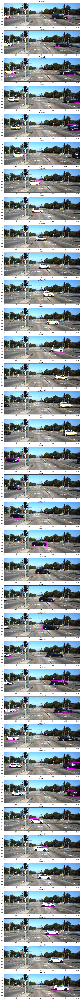

In [29]:
f, ax = plt.subplots(NUM_FRAMES, figsize=(300,150))
for i in range(NUM_FRAMES):
    
    image_tag = int_to_tag_format(i)
    bboxes = np.zeros((len(cars), 7))
    
    for j, car in enumerate(cars):
        try:
            bboxes[j] = car.bounding_boxes[i]
        except:
            pass
        
    bbox_image = draw_bbox_on_img(image_tag, gt_boxes=bboxes)
    ax[i].imshow(bbox_image)
    ax[i].set_title('Frame {}'.format(i))
plt.show()

### Plotting bounding box for one car
Here we plot only the bounding box of the first car observed by the object tracking code. We can see that the boxes associated with `Car1` are all attached to the same car in the frame. This demonstrates the ability of the object tracking code to assign boxes to individual cars

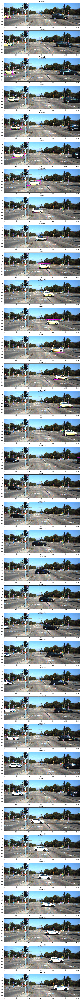

In [30]:
f, ax = plt.subplots(NUM_FRAMES, figsize=(300,150))
for i in range(NUM_FRAMES):
    
    image_tag = int_to_tag_format(i)
    bboxes = np.zeros((len(cars), 7))
    
    try:
        bboxes[0] = cars[0].bounding_boxes[i]
    except Exception as e:
        pass
        
    bbox_image = draw_bbox_on_img(image_tag, gt_boxes=bboxes)
    ax[i].imshow(bbox_image)
    ax[i].set_title('Frame {}'.format(i))
plt.show()

# Bounding Box Regression

In [31]:
from sklearn.linear_model import LinearRegression

In [32]:
for car in cars:
    car.train_reg_model()

In [33]:
for car in cars:
    print(car.name)
    preds, mae, mse, frame_range = car.test()
    print('frame range: {}'.format(frame_range))
    print('mean absolute error: \n{}'.format(mae))
    print('mean squared error: \n{}\n\n'.format(mse))

Car1
frame range: (11, 16)
mean absolute error: 
[0.2206869  2.01627518 0.06900803 0.04892818 0.03833447 0.11346525
 0.06582563]
mean squared error: 
[5.64633277e-02 4.72691131e+00 5.61117710e-03 3.39681318e-03
 2.48306490e-03 1.40571682e-02 9.36193023e-03]


Car2
frame range: (4, 5)
mean absolute error: 
[0.02450151 0.06424103 0.06005048 0.08170205 0.03596868 0.05692832
 0.04921524]
mean squared error: 
[0.00082827 0.00412723 0.00381769 0.00721085 0.00149966 0.00385942
 0.00242405]


Car3
frame range: (24, 28)
mean absolute error: 
[0.94348025 5.36665573 0.06152711 0.03688892 0.05713278 0.46378156
 0.05736794]
mean squared error: 
[1.02125798e+00 3.17446930e+01 4.50662092e-03 1.94070587e-03
 3.94701920e-03 2.55235145e-01 5.68519140e-03]


Car4
frame range: (31, 35)
mean absolute error: 
[0.17280459 0.7526234  0.020718   0.03453758 0.01795451 0.06899308
 0.0284857 ]
mean squared error: 
[4.80447000e-02 7.82423987e-01 6.10936827e-04 1.37471275e-03
 6.68387260e-04 5.87091893e-03 1.436091

### Visualization
Here we visualize the predictions of the linear regression models by plotting each image in the sequence with the detected current bounding box as well as the predicted future box.

Current boxes are <span style="color: #ff00ff">Magenta</span>.

Predicted future boxes are <span style="color: #00ffff">Cyan</span>.

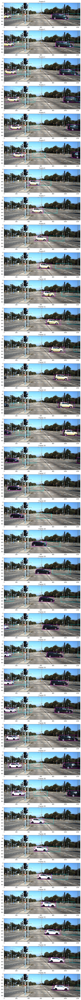

In [34]:
from IPython.display import Markdown
display (Markdown('Current boxes are <span style="color: #ff00ff">Magenta</span>.'))
display (Markdown('Predicted future boxes are <span style="color: #00ffff">Cyan</span>.'))

f, ax = plt.subplots(NUM_FRAMES, figsize=(300,150))
for i in range(NUM_FRAMES):
    
    image_tag = int_to_tag_format(i)
    pred_boxes = np.zeros((len(cars), 7))
    gt_boxes = np.zeros((len(cars), 7))
    
    for j, car in enumerate(cars):
        if (i in car.bounding_boxes and car.reg_model_fitted):
            gt_boxes[j] = car.bounding_boxes[i]
            pred_boxes[j] = car.predict(i+3)
        
    bbox_image = draw_bbox_on_img(image_tag, pred_boxes, gt_boxes)
    ax[i].imshow(bbox_image)
    ax[i].set_title('Frame {}'.format(i))
plt.show()

### GIF
Finally, make each frame in the sequence, with current and future boxes, into a video to visualize the outputs of the entire model.<br>
This code is based on some visualization techniques from Alex Staravoitau (github: https://github.com/navoshta/KITTI-Dataset)

In [35]:
GIF_DIR = 'predictions/video/drive_{}'.format(DRIVE)
os.system('mkdir -p {}/frames'.format(GIF_DIR))

0

In [36]:
from moviepy.editor import ImageSequenceClip
import sys

# Print iterations progress
def print_progress(iteration, total):
    """
    Call in a loop to create terminal progress bar

    Parameters
    ----------

    iteration :
                Current iteration (Int)
    total     :
                Total iterations (Int)
    """
    str_format = "{0:.0f}"
    percents = str_format.format(100 * (iteration / float(total)))
    filled_length = int(round(100 * iteration / float(total)))
    bar = '█' * filled_length + '-' * (100 - filled_length)

    sys.stdout.write('\r |%s| %s%%' % (bar, percents)),

    if iteration == total:
        sys.stdout.write('\n')
    sys.stdout.flush()

def make_frame(frame, image_tag, pred_boxes, gt_boxes):
    f = plt.figure(figsize=(12, 4))
    axis = f.add_subplot(111)
    bbox_image = draw_bbox_on_img(image_tag, pred_boxes, gt_boxes)
    axis.imshow(bbox_image)
    filename = '{}/frames/frame_{}.png'.format(GIF_DIR, frame)
    plt.savefig(filename)
    plt.close(f)
    return filename

def make_gif():
    frames = []
    
    print('Preparing animation frames...')
    for i in range(NUM_FRAMES):
        print_progress(i, NUM_FRAMES - 1)
        
        image_tag = int_to_tag_format(i)
        pred_boxes = np.zeros((len(cars), 7))
        gt_boxes = np.zeros((len(cars), 7))

        for j, car in enumerate(cars):
            if (i in car.bounding_boxes and car.reg_model_fitted):
                gt_boxes[j] = car.bounding_boxes[i]
                pred_boxes[j] = car.predict(i+3)
        
        filename = make_frame(i, image_tag, pred_boxes, gt_boxes)
        frames += [filename]
    print('...Animation frames ready.')

    clip = ImageSequenceClip(frames, fps=5)
    clip.write_gif('{}/drive_{}_predictions.gif'.format(GIF_DIR, DRIVE), fps=5)

In [37]:
make_gif()

Preparing animation frames...
 |████████████████████████████████████████████████████████████████████████████████████████████████████| 100%
...Animation frames ready.


t:   0%|          | 0/37 [00:00<?, ?it/s, now=None]

MoviePy - Building file predictions/video/drive_0017/drive_0017_predictions.gif with imageio.


![Predictions](predictions/video/drive_0017/drive_0017_predictions.gif "segment")